<a href="https://colab.research.google.com/github/dharshu2323/Anime-image-generator-using-DCGAN/blob/main/dcgan_anime.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import os
import numpy as np
import matplotlib.pyplot as plt
import warnings
from tqdm.notebook import tqdm

In [ ]:
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.preprocessing.image import load_img, array_to_img
from tensorflow.keras.models import Sequential,Model
from tensorflow.keras import layers
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.losses import BinaryCrossentropy
warnings.filterwarnings('ignore')

In [ ]:
#Load the dataset
BASE_DIR='/kaggle/input/anime-faces/data/'

In [ ]:
image_paths=[]
for image in os.listdir(BASE_DIR):
    image_path=os.path.join(BASE_DIR,image)
    image_paths.append(image_path)

In [ ]:
#remove unnessary file
image_paths.remove('/kaggle/input/anime-faces/data/data')

In [ ]:
len(image_paths)

21551

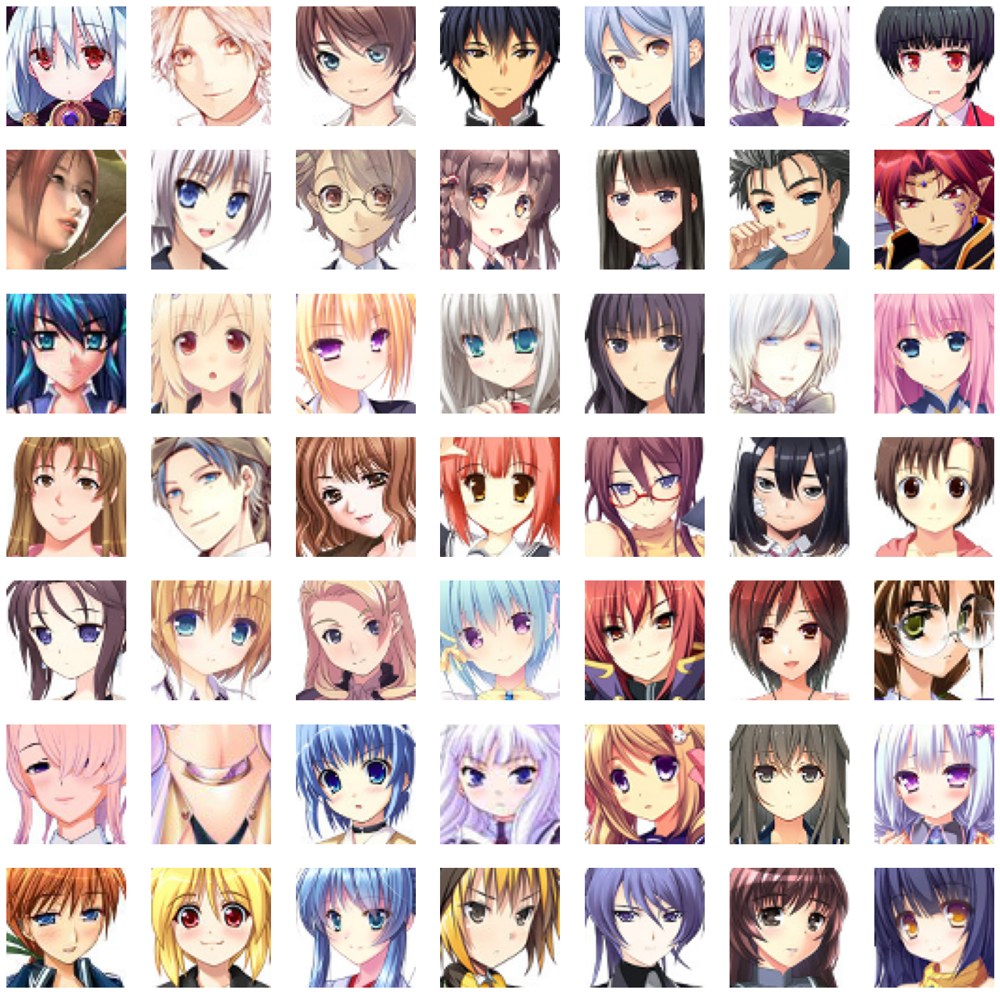

In [ ]:
#Visualizing the data
plt.figure(figsize=(20,20))
tem_image=image_paths[:49]
index=1

for image_path in tem_image:
    plt.subplot(7,7,index)
    img=load_img(image_path)
    img=np.array(img)
    plt.imshow(img)
    plt.axis('off')
    index+=1


In [ ]:
#Data Preprocessing
train_images=[np.array(load_img(path)) for path in tqdm(image_paths)]
train_images=np.array(train_images)

  0%|          | 0/21551 [00:00<?, ?it/s]

In [ ]:
train_images.shape

(21551, 64, 64, 3)

In [ ]:
train_images[2].shape

(64, 64, 3)

In [ ]:
train_images=train_images.reshape(train_images.shape[0],64,64,3).astype('float32')

In [ ]:
#Normalize
train_images=(train_images-127.5)/127.5

In [ ]:
train_images[0]

array([[[-0.7254902 , -0.90588236, -0.7176471 ],
        [-0.70980394, -0.88235295, -0.6862745 ],
        [-0.7019608 , -1.        , -0.7176471 ],
        ...,
        [-0.09019608,  0.01176471,  0.3882353 ],
        [-0.19215687,  0.05882353,  0.4509804 ],
        [-0.34117648, -0.13725491,  0.29411766]],

       [[-0.7254902 , -0.90588236, -0.7176471 ],
        [-0.73333335, -0.8666667 , -0.7019608 ],
        [-0.52156866, -0.8666667 , -0.5686275 ],
        ...,
        [-0.29411766,  0.01176471,  0.3019608 ],
        [-0.08235294,  0.15294118,  0.5294118 ],
        [-0.23921569,  0.09019608,  0.45882353]],

       [[-0.7019608 , -0.8901961 , -0.7019608 ],
        [-0.7176471 , -0.8745098 , -0.69411767],
        [-0.5686275 , -0.8509804 , -0.58431375],
        ...,
        [-0.22352941,  0.1764706 ,  0.48235294],
        [-0.13725491,  0.1764706 ,  0.4745098 ],
        [-0.06666667,  0.24705882,  0.5058824 ]],

       ...,

       [[-0.30980393, -0.6862745 , -0.29411766],
        [-0

## Generator and Discriminator

In [ ]:
#latent dimension for random noise
LATENT_DIR=100
WEIGHT_INIT=keras.initializers.random_normal(mean=0.0,stddev=0.02)
CHANNELS=3

GENERATOR MODEL

In [ ]:
model=Sequential(name='generator')
model.add(layers.Dense(8*8*512,input_dim=LATENT_DIR))
#model.add(layers.BatchNormalization())
model.add(layers.ReLU())

#conert 1d to 3d
model.add(layers.Reshape((8,8,512)))

#upsample to 16*16
model.add(layers.Conv2DTranspose(256,(4,4),strides=(2,2),padding='same',kernel_initializer=WEIGHT_INIT))
#model.add(layers.BatchNormalization())
model.add(layers.ReLU())

#upsample to 32*32
model.add(layers.Conv2DTranspose(128,(4,4),strides=(2,2),padding='same',kernel_initializer=WEIGHT_INIT))
#model.add(layers.BatchNormalization())
model.add(layers.ReLU())

#upsample to 64*64
model.add(layers.Conv2DTranspose(64,(4,4),strides=(2,2),padding='same',kernel_initializer=WEIGHT_INIT))
#model.add(layers.BatchNormalization())
model.add(layers.ReLU())

model.add(layers.Conv2D(CHANNELS,(4,4),padding='same',activation='tanh'))
generator=model
generator.summary()

Model: "generator"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ dense_12 (Dense)                │ (None, 32768)          │     3,309,568 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ re_lu_24 (ReLU)                 │ (None, 32768)          │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ reshape_6 (Reshape)             │ (None, 8, 8, 512)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_transpose_18             │ (None, 16, 16, 256)    │     2,097,408 │
│ (Conv2DTranspose)               │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ re_lu_25 (ReLU)                 │ (None, 16, 16, 256)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_transpose_19             │ (None, 32, 32, 128)    │       524,416 │
│ (Conv2DTranspose)               │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ re_lu_26 (ReLU)                 │ (None, 32, 32, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_transpose_20             │ (None, 64, 64, 64)     │       131,136 │
│ (Conv2DTranspose)               │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ re_lu_27 (ReLU)                 │ (None, 64, 64, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_24 (Conv2D)              │ (None, 64, 64, 3)      │         3,075 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 6,065,603 (23.14 MB)

 Trainable params: 6,065,603 (23.14 MB)

 Non-trainable params: 0 (0.00 B)

Discriminator model

In [ ]:
model=Sequential(name='discriminator')

input_shape=(64,64,3)
alpha=0.2

#Downsampling
model.add(layers.Conv2D(64,(4,4),strides=(2,2),padding='same',input_shape=input_shape))
model.add(layers.BatchNormalization())
model.add(layers.LeakyReLU(alpha=alpha))

model.add(layers.Conv2D(128,(4,4),strides=(2,2),padding='same',input_shape=input_shape))
model.add(layers.BatchNormalization())
model.add(layers.LeakyReLU(alpha=alpha))

model.add(layers.Conv2D(128,(4,4),strides=(2,2),padding='same',input_shape=input_shape))
model.add(layers.BatchNormalization())
model.add(layers.LeakyReLU(alpha=alpha))

model.add(layers.Flatten())
model.add(layers.Dropout(0.3))

#output class
model.add(layers.Dense(1,activation='sigmoid'))

discriminator=model
discriminator.summary()

Model: "discriminator"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ conv2d_25 (Conv2D)              │ (None, 32, 32, 64)     │         3,136 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_22          │ (None, 32, 32, 64)     │           256 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_18 (LeakyReLU)      │ (None, 32, 32, 64)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_26 (Conv2D)              │ (None, 16, 16, 128)    │       131,200 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_23          │ (None, 16, 16, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_19 (LeakyReLU)      │ (None, 16, 16, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_27 (Conv2D)              │ (None, 8, 8, 128)      │       262,272 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_24          │ (None, 8, 8, 128)      │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_20 (LeakyReLU)      │ (None, 8, 8, 128)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten_6 (Flatten)             │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dropout_6 (Dropout)             │ (None, 8192)           │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ dense_13 (Dense)                │ (None, 1)              │         8,193 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 406,081 (1.55 MB)

 Trainable params: 405,441 (1.55 MB)

 Non-trainable params: 640 (2.50 KB)

# **DCGAN model**

In [ ]:
class DCGAN(keras.Model):
    def __init__(self,generator,discriminator,LATENT_DIR):
        super().__init__()
        self.generator=generator
        self.discriminator=discriminator
        self.LATENT_DIR=LATENT_DIR
        self.g_loss_metric=keras.metrics.Mean(name='g_loss')
        self.d_loss_metric=keras.metrics.Mean(name='d_loss')

    @property
    def metrics(self):
        return [self.g_loss_metric,self.d_loss_metric]

    def compile(self,g_optimizer,d_optimizer,loss_fn):
        super(DCGAN,self).compile()
        self.g_optimizer=g_optimizer
        self.d_optimizer=d_optimizer
        self.loss_fn=loss_fn

    def train_step(self,real_images):
        batch_size=tf.shape(real_images)[0]
        #generate random noise
        random_noise=tf.random.normal(shape=(batch_size,self.LATENT_DIR))

        #training the discriminator with real(1) and fake(0) images

        with tf.GradientTape() as tape:
            pred_real=self.discriminator(real_images,training=True)
            #generate real image labels
            real_labels=tf.ones((batch_size,1))
            real_labels+=0.05 * tf.random.uniform(tf.shape(real_labels))
            d_loss_real = self.loss_fn(real_labels,pred_real)

            #fake images
            fake_images=self.generator(random_noise)
            pred_fake=self.discriminator(fake_images,training=True)
            fake_labels=tf.zeros((batch_size,1))
            d_loss_fake=self.loss_fn(fake_labels,pred_fake)

            #total discriminator loss
            d_loss=(d_loss_real + d_loss_fake)/2

        gradients=tape.gradient(d_loss,self.discriminator.trainable_variables)
        self.d_optimizer.apply_gradients(zip(gradients,self.discriminator.trainable_variables))


        #train the generator
        labels=tf.ones((batch_size,1))
        with tf.GradientTape() as tape:
            fake_images=self.generator(random_noise,training=True)
            pred_fake=self.discriminator(fake_images,training=True)
            #loss fn
            g_loss=self.loss_fn(labels,pred_fake)

        gradients=tape.gradient(g_loss,self.generator.trainable_variables)
        self.g_optimizer.apply_gradients(zip(gradients,self.generator.trainable_variables))
        self.d_loss_metric.update_state(d_loss)
        self.d_loss_metric.update_state(g_loss)

        return {'d_loss': self.d_loss_metric.result(),'g_loss':self.g_loss_metric.result()}


In [ ]:
class DCGANMonitor(keras.callbacks.Callback):
    def __init__(self,num_imgs=25,latent_dim=100):
        self.num_imgs=num_imgs
        self.latent_dim=latent_dim
        self.noise=tf.random.normal([25,latent_dim]) #Random noise

    def on_epoch_end(self,epoch,logs=None):
        g_img=self.model.generator(self.noise)
        g_img=(g_img *127.5)+127.5
        g_img.numpy()

        fig=plt.figure(figsize=(8,8))

        for i in range(self.num_imgs):
            plt.subplot(5,5,i+1)
            img=array_to_img(g_img[i])
            plt.imshow(img)
            plt.axis('off')
        #plt.savefig('epoch_{:03d}.png'.format(epoch))

        plt.show()

    def on_train_end(self,logs=None):
        self.model.generator.save('generator.h5')




In [ ]:
dcgan=DCGAN(generator,discriminator,LATENT_DIR)

In [ ]:
D_LR=0.0001
G_LR=0.0003
dcgan.compile(g_optimizer=Adam(learning_rate=G_LR,beta_1=0.5),d_optimizer=Adam(D_LR,beta_1=0.5),loss_fn=BinaryCrossentropy())

Epoch 1/50
  5/674 ━━━━━━━━━━━━━━━━━━━━ 20s 31ms/step - d_loss: 1.0045 - g_loss: 0.0000e+00 

W0000 00:00:1716919143.958421     107 graph_launch.cc:671] Fallback to op-by-op mode because memset node breaks graph update


674/674 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step - d_loss: 1.5490 - g_loss: 0.0000e+00

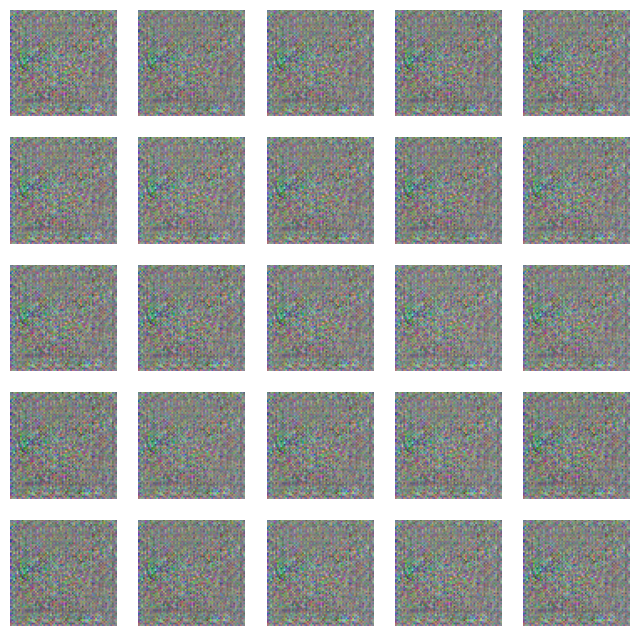

674/674 ━━━━━━━━━━━━━━━━━━━━ 46s 49ms/step - d_loss: 1.5492 - g_loss: 0.0000e+00
Epoch 2/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - d_loss: 1.4661 - g_loss: 0.0000e+00

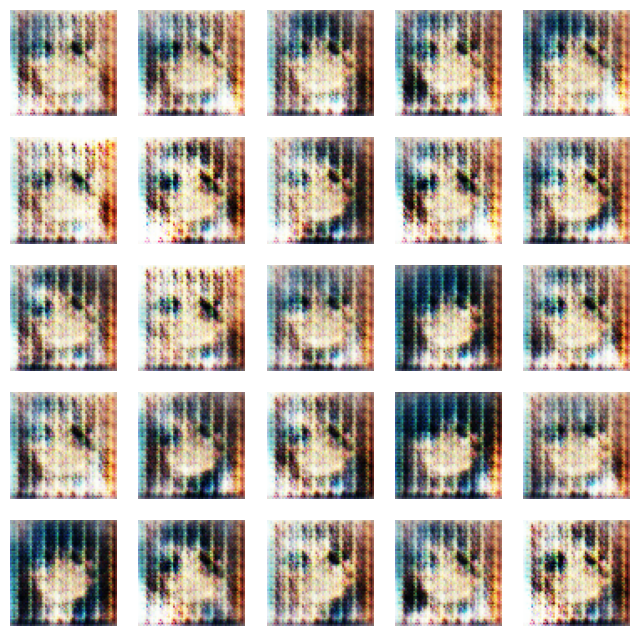

674/674 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - d_loss: 1.4654 - g_loss: 0.0000e+00
Epoch 3/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - d_loss: 1.0981 - g_loss: 0.0000e+00

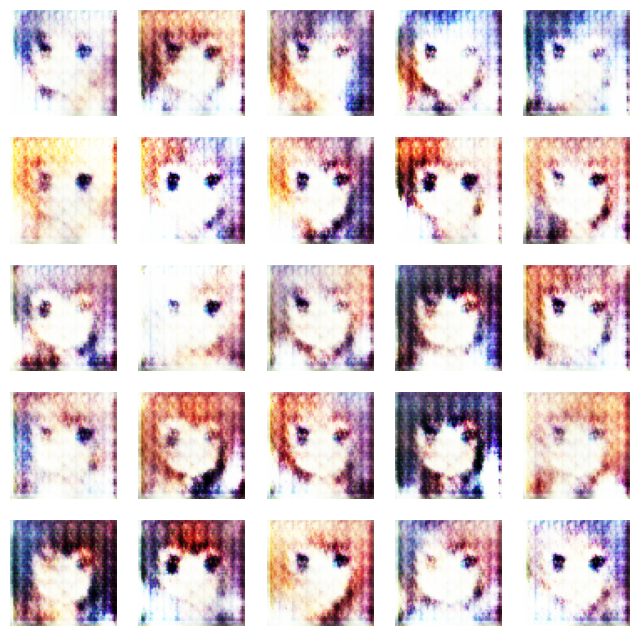

674/674 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - d_loss: 1.0981 - g_loss: 0.0000e+00
Epoch 4/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - d_loss: 1.1064 - g_loss: 0.0000e+00

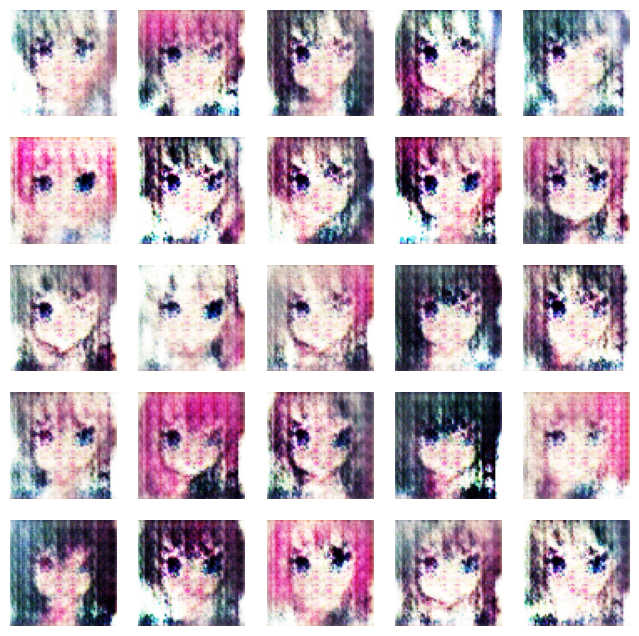

674/674 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - d_loss: 1.1064 - g_loss: 0.0000e+00
Epoch 5/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - d_loss: 1.0588 - g_loss: 0.0000e+00

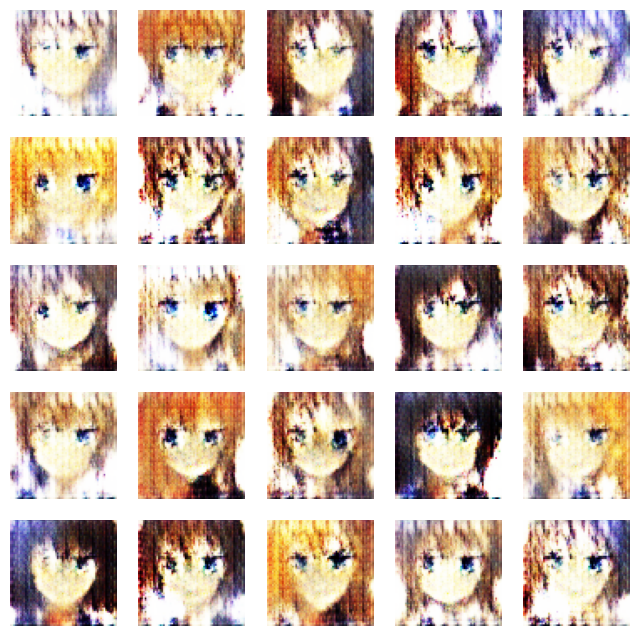

674/674 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - d_loss: 1.0588 - g_loss: 0.0000e+00
Epoch 6/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - d_loss: 1.0608 - g_loss: 0.0000e+00

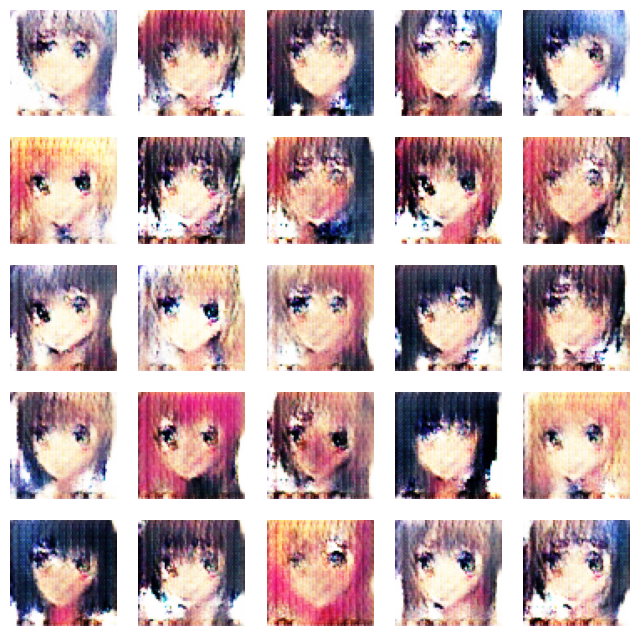

674/674 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - d_loss: 1.0608 - g_loss: 0.0000e+00
Epoch 7/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - d_loss: 1.0531 - g_loss: 0.0000e+00

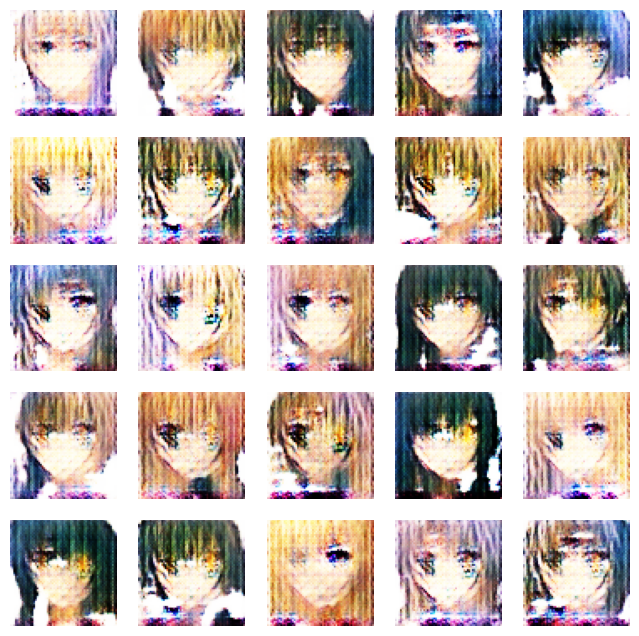

674/674 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - d_loss: 1.0531 - g_loss: 0.0000e+00
Epoch 8/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - d_loss: 1.0420 - g_loss: 0.0000e+00

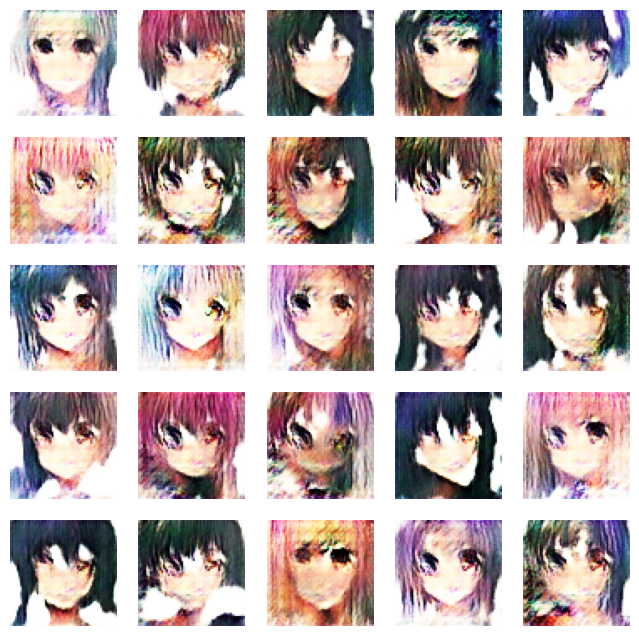

674/674 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - d_loss: 1.0420 - g_loss: 0.0000e+00
Epoch 9/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - d_loss: 1.0074 - g_loss: 0.0000e+00

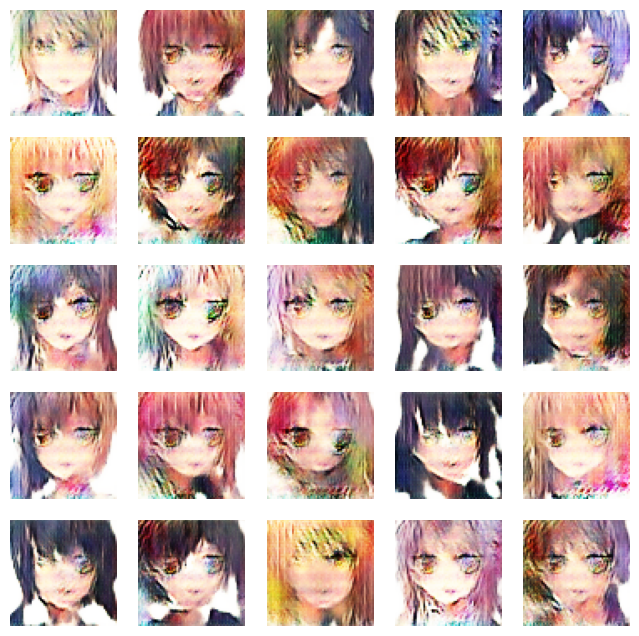

674/674 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - d_loss: 1.0074 - g_loss: 0.0000e+00
Epoch 10/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - d_loss: 0.9236 - g_loss: 0.0000e+00

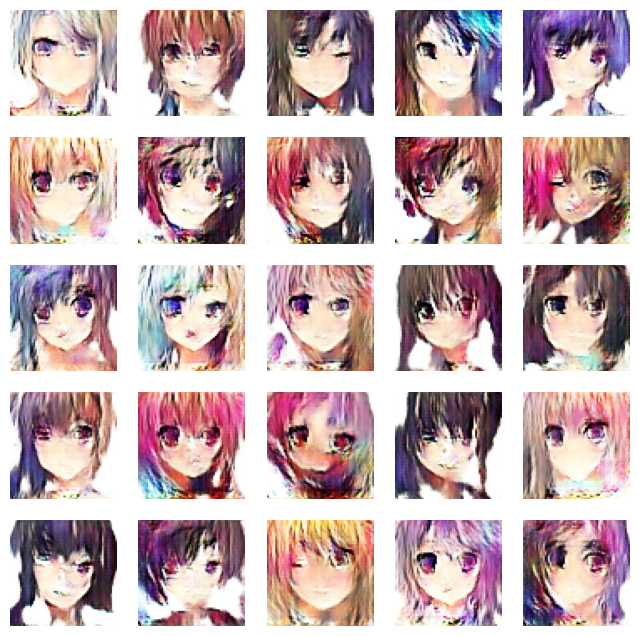

674/674 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - d_loss: 0.9236 - g_loss: 0.0000e+00
Epoch 11/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - d_loss: 0.8669 - g_loss: 0.0000e+00

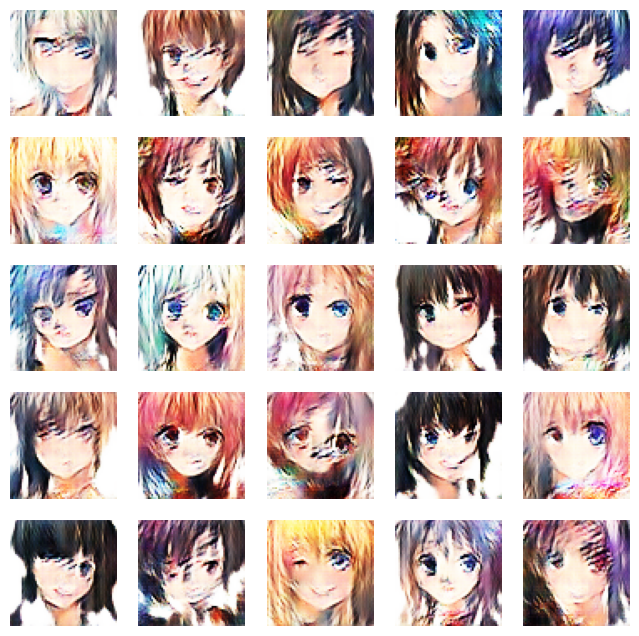

674/674 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - d_loss: 0.8669 - g_loss: 0.0000e+00
Epoch 12/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - d_loss: 0.8439 - g_loss: 0.0000e+00

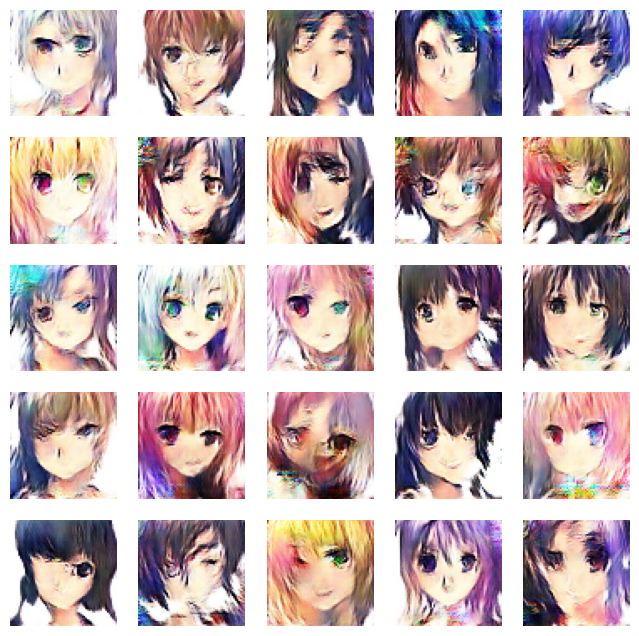

674/674 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - d_loss: 0.8439 - g_loss: 0.0000e+00
Epoch 13/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - d_loss: 0.8241 - g_loss: 0.0000e+00

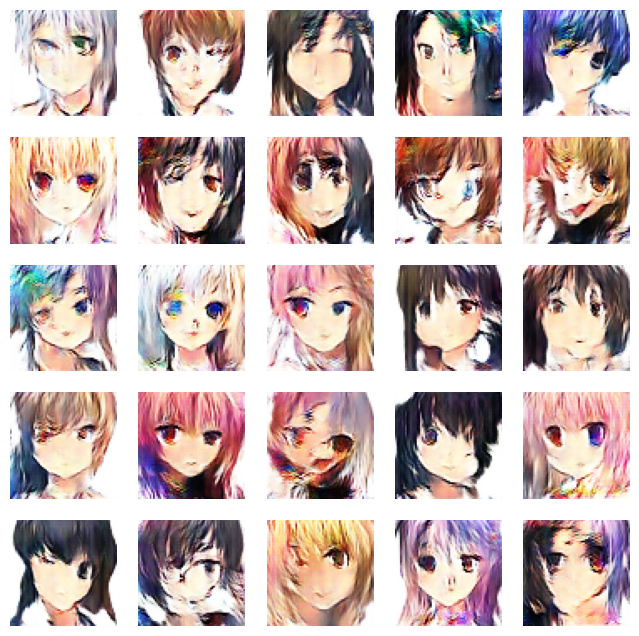

674/674 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - d_loss: 0.8240 - g_loss: 0.0000e+00
Epoch 14/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - d_loss: 0.8052 - g_loss: 0.0000e+00

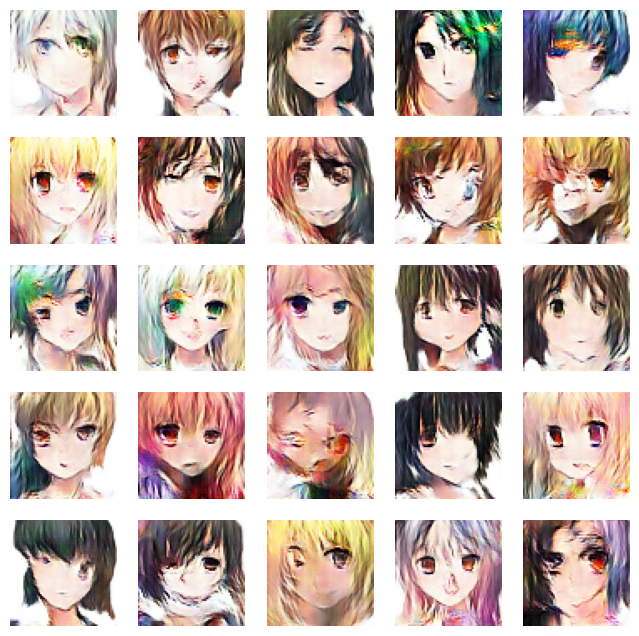

674/674 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - d_loss: 0.8052 - g_loss: 0.0000e+00
Epoch 15/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - d_loss: 0.7929 - g_loss: 0.0000e+00

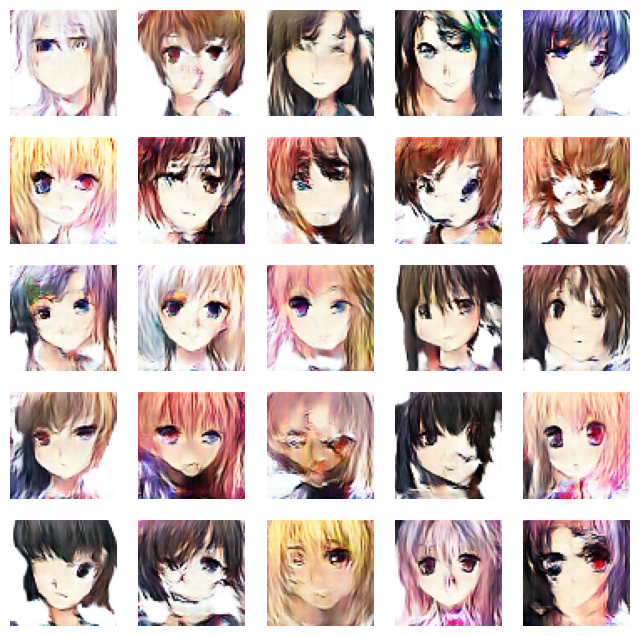

674/674 ━━━━━━━━━━━━━━━━━━━━ 21s 32ms/step - d_loss: 0.7929 - g_loss: 0.0000e+00
Epoch 16/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - d_loss: 0.7775 - g_loss: 0.0000e+00

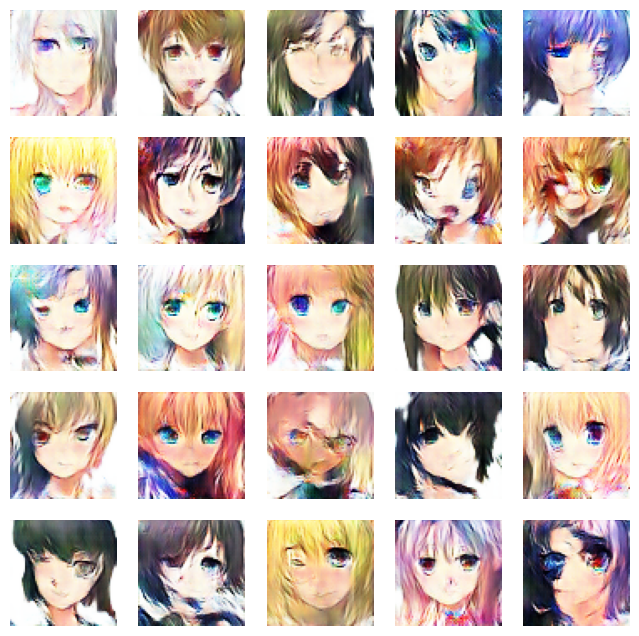

674/674 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - d_loss: 0.7775 - g_loss: 0.0000e+00
Epoch 17/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - d_loss: 0.7828 - g_loss: 0.0000e+00

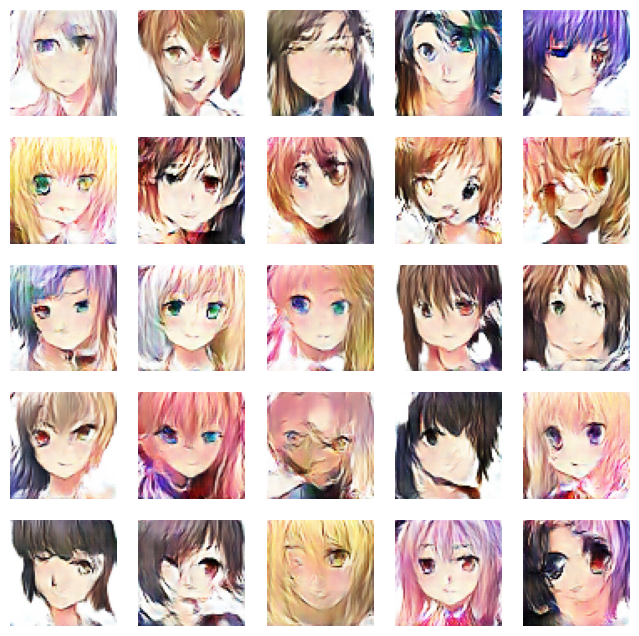

674/674 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - d_loss: 0.7828 - g_loss: 0.0000e+00
Epoch 18/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - d_loss: 0.7712 - g_loss: 0.0000e+00

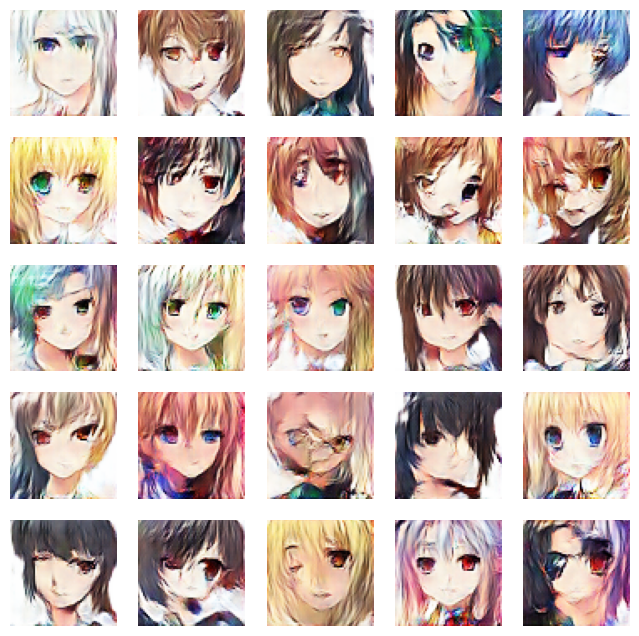

674/674 ━━━━━━━━━━━━━━━━━━━━ 21s 30ms/step - d_loss: 0.7712 - g_loss: 0.0000e+00
Epoch 19/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - d_loss: 0.7725 - g_loss: 0.0000e+00

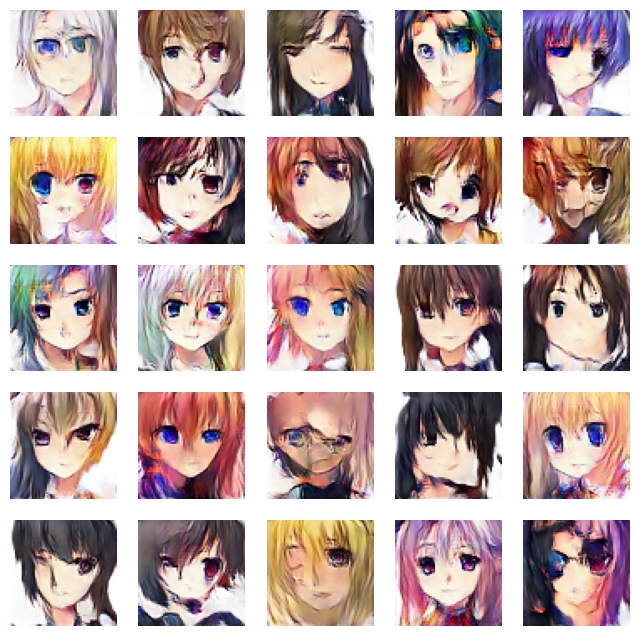

674/674 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - d_loss: 0.7725 - g_loss: 0.0000e+00
Epoch 20/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - d_loss: 0.7670 - g_loss: 0.0000e+00

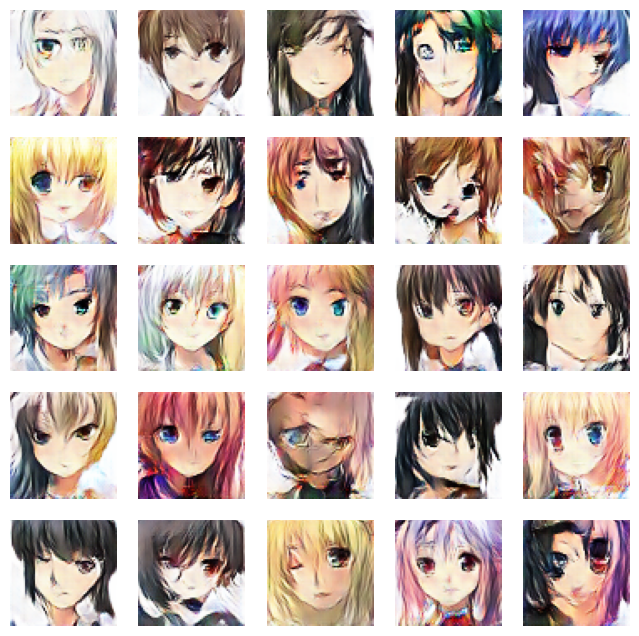

674/674 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - d_loss: 0.7670 - g_loss: 0.0000e+00
Epoch 21/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - d_loss: 0.7637 - g_loss: 0.0000e+00

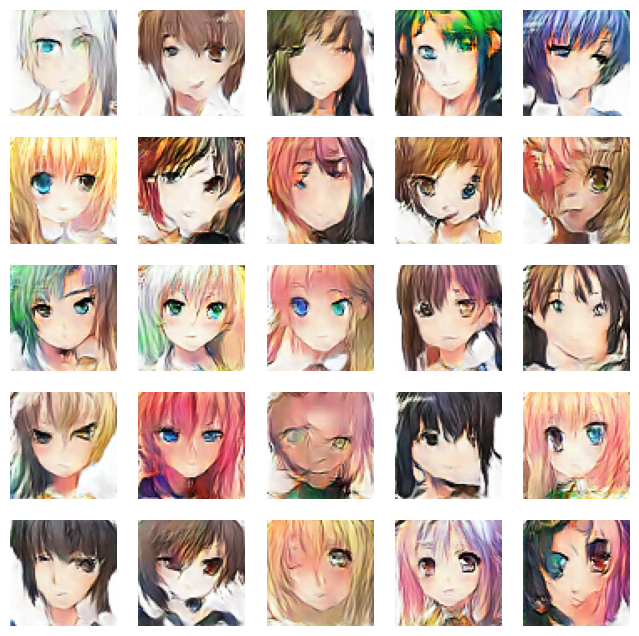

674/674 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - d_loss: 0.7637 - g_loss: 0.0000e+00
Epoch 22/50
672/674 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - d_loss: 0.7606 - g_loss: 0.0000e+00

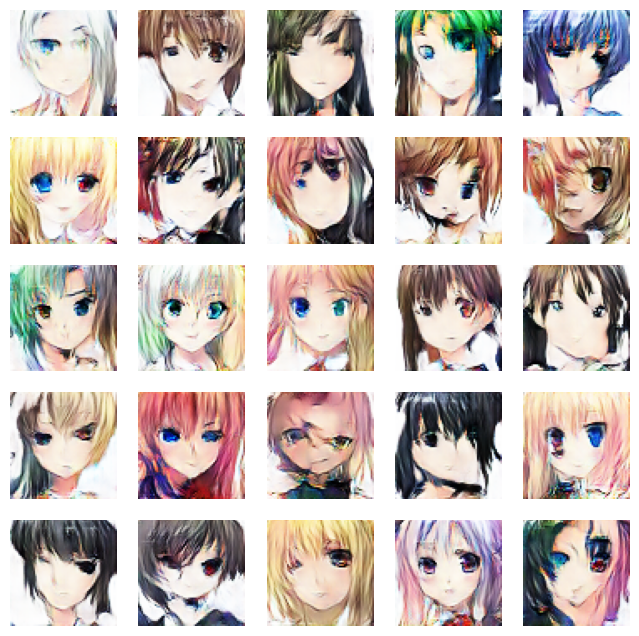

674/674 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - d_loss: 0.7606 - g_loss: 0.0000e+00
Epoch 23/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - d_loss: 0.7600 - g_loss: 0.0000e+00

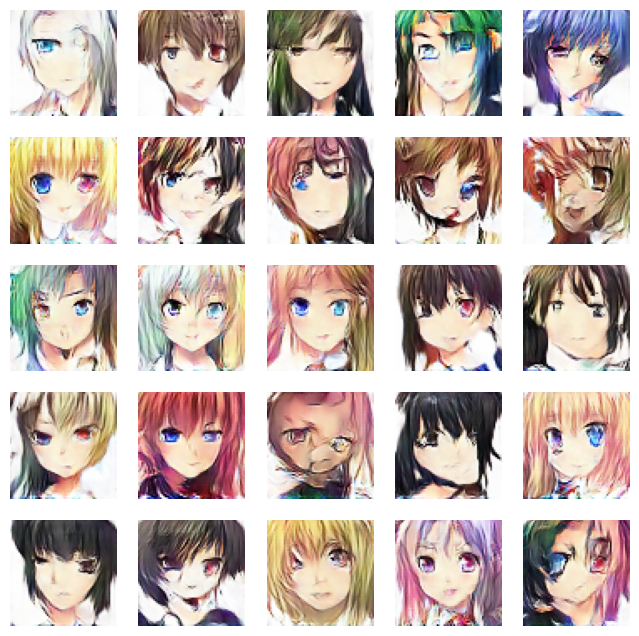

674/674 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - d_loss: 0.7600 - g_loss: 0.0000e+00
Epoch 24/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - d_loss: 0.7585 - g_loss: 0.0000e+00

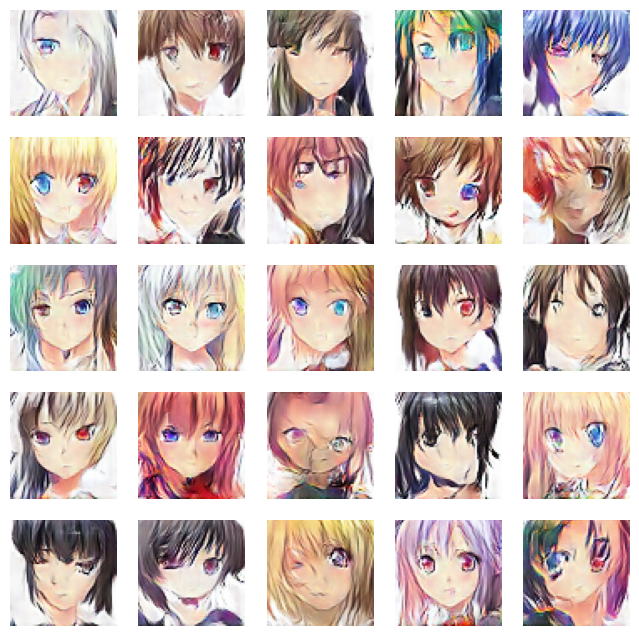

674/674 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - d_loss: 0.7585 - g_loss: 0.0000e+00
Epoch 25/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - d_loss: 0.7588 - g_loss: 0.0000e+00

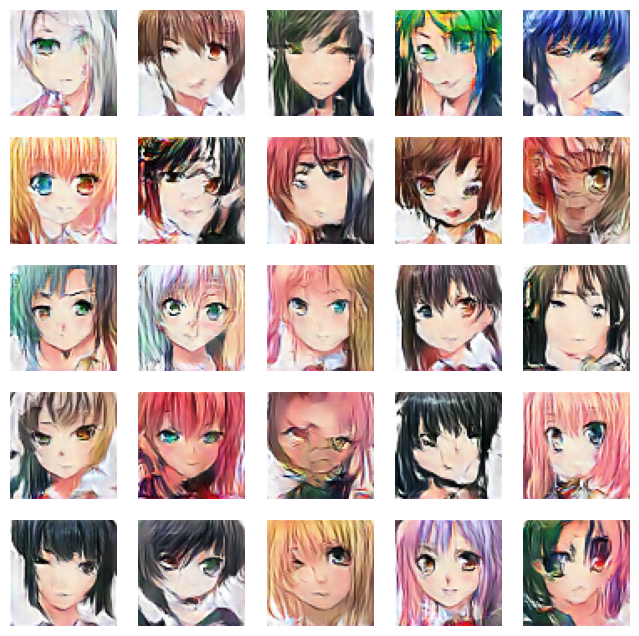

674/674 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - d_loss: 0.7588 - g_loss: 0.0000e+00
Epoch 26/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - d_loss: 0.7571 - g_loss: 0.0000e+00

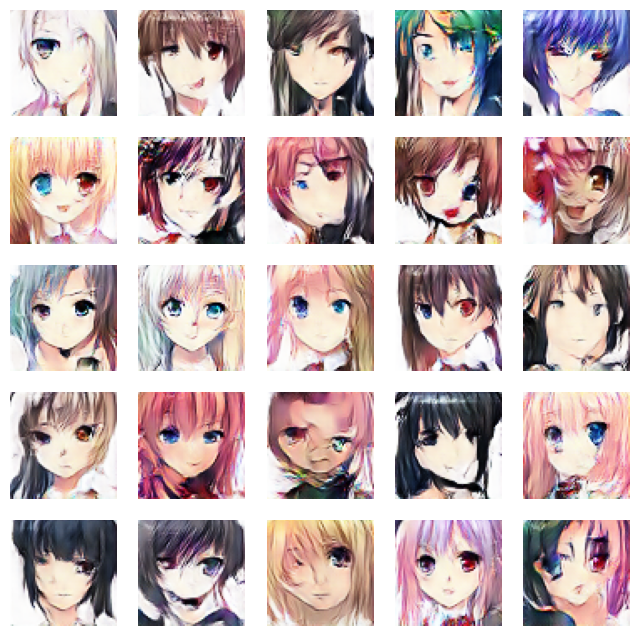

674/674 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - d_loss: 0.7571 - g_loss: 0.0000e+00
Epoch 27/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - d_loss: 0.7671 - g_loss: 0.0000e+00

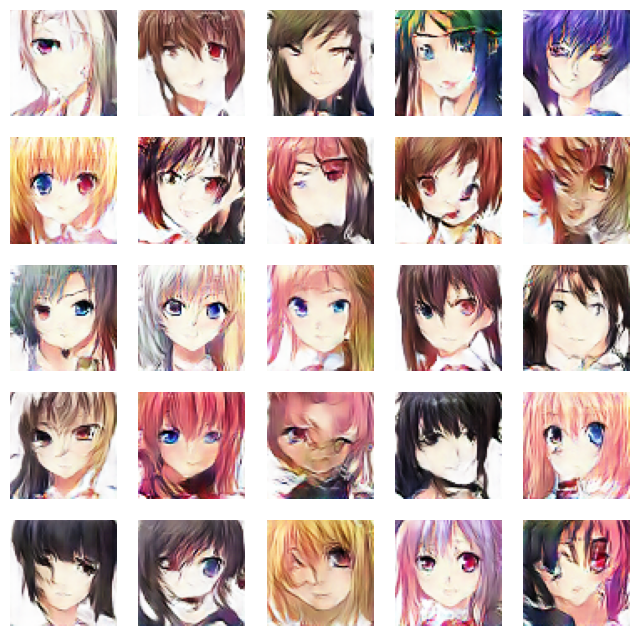

674/674 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - d_loss: 0.7671 - g_loss: 0.0000e+00
Epoch 28/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - d_loss: 0.7593 - g_loss: 0.0000e+00

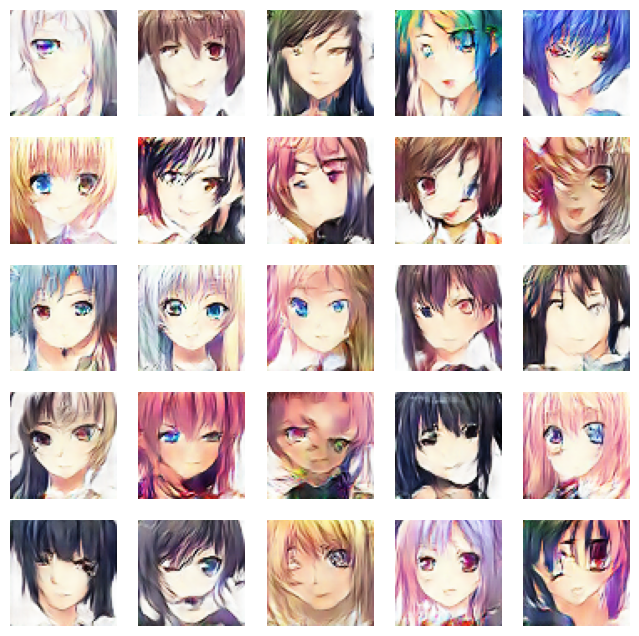

674/674 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - d_loss: 0.7594 - g_loss: 0.0000e+00
Epoch 29/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - d_loss: 0.7643 - g_loss: 0.0000e+00

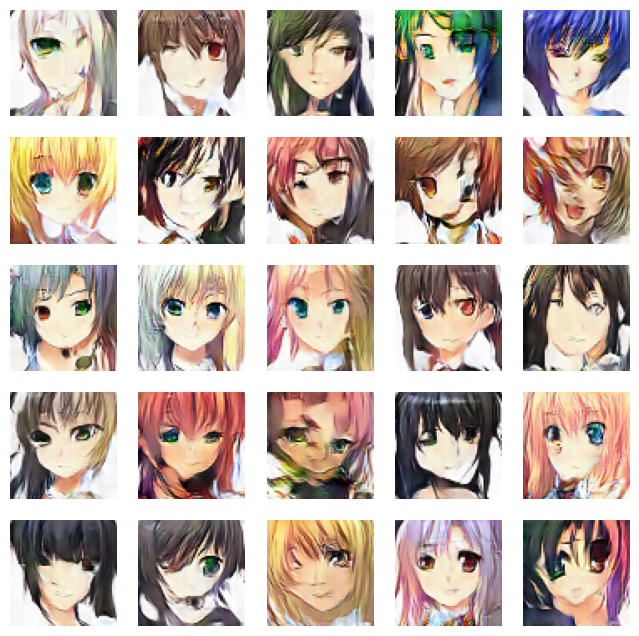

674/674 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - d_loss: 0.7643 - g_loss: 0.0000e+00
Epoch 30/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - d_loss: 0.7674 - g_loss: 0.0000e+00

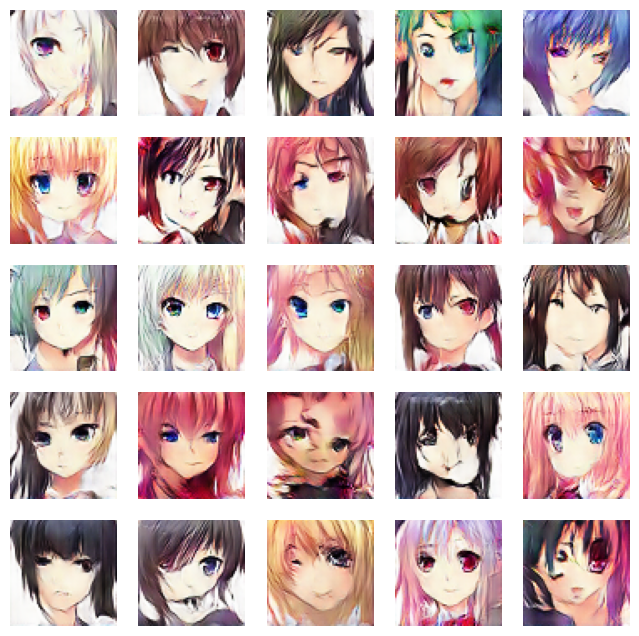

674/674 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - d_loss: 0.7674 - g_loss: 0.0000e+00
Epoch 31/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - d_loss: 0.7735 - g_loss: 0.0000e+00

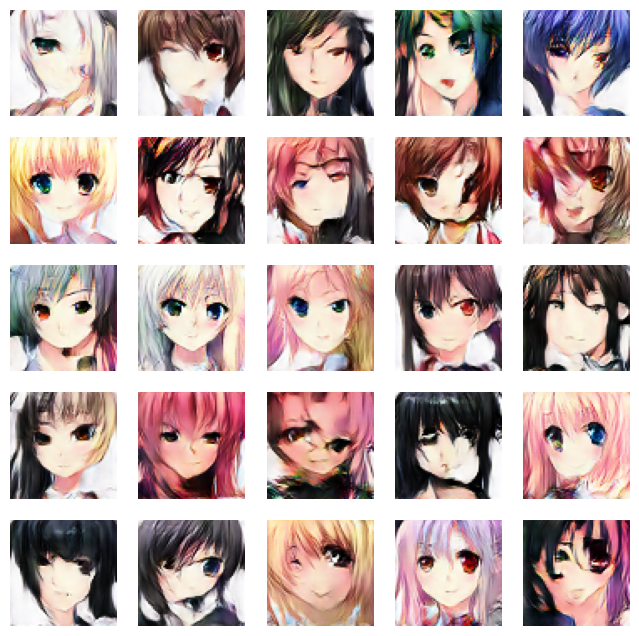

674/674 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - d_loss: 0.7735 - g_loss: 0.0000e+00
Epoch 32/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - d_loss: 0.7781 - g_loss: 0.0000e+00

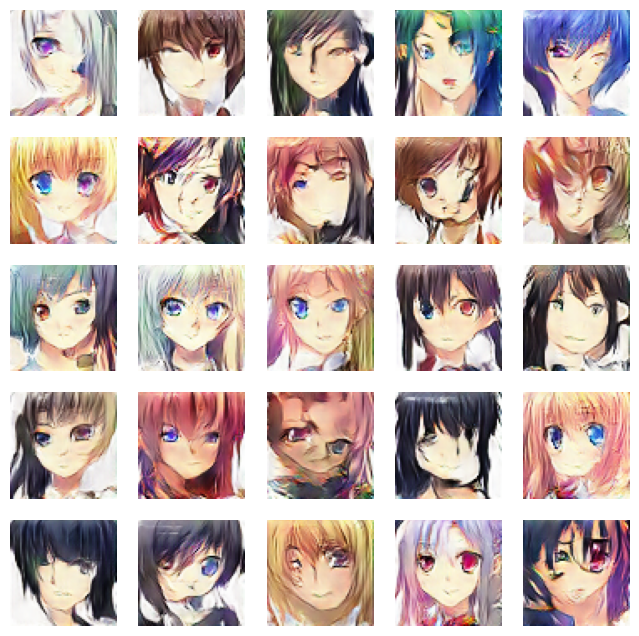

674/674 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - d_loss: 0.7781 - g_loss: 0.0000e+00
Epoch 33/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - d_loss: 0.7817 - g_loss: 0.0000e+00

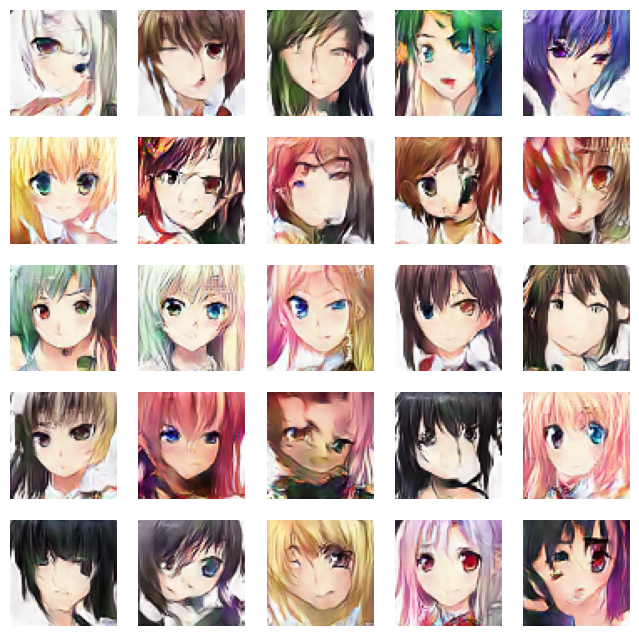

674/674 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - d_loss: 0.7817 - g_loss: 0.0000e+00
Epoch 34/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - d_loss: 0.7854 - g_loss: 0.0000e+00

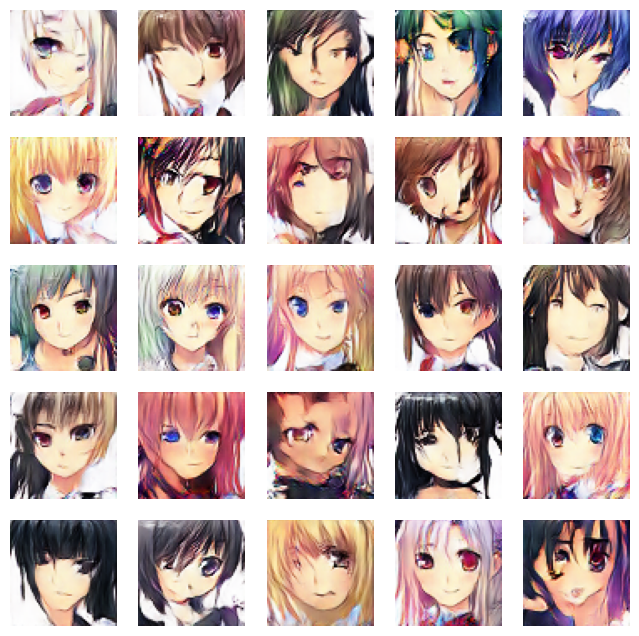

674/674 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - d_loss: 0.7854 - g_loss: 0.0000e+00
Epoch 35/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - d_loss: 0.7894 - g_loss: 0.0000e+00

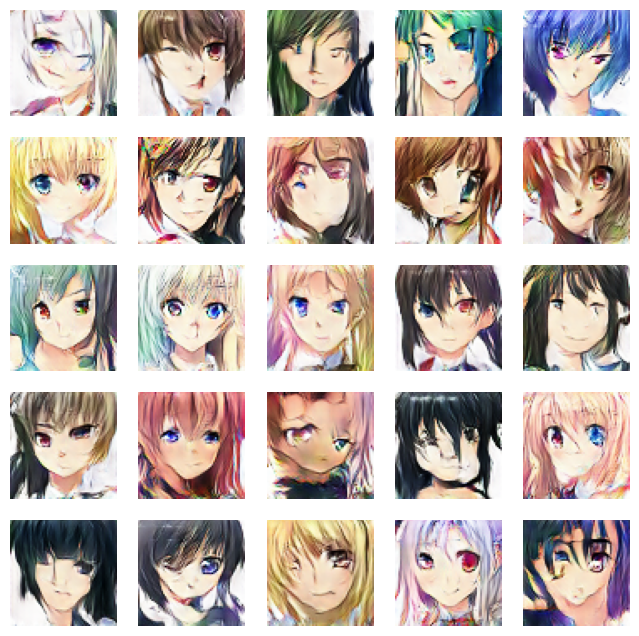

674/674 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - d_loss: 0.7894 - g_loss: 0.0000e+00
Epoch 36/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - d_loss: 0.7934 - g_loss: 0.0000e+00

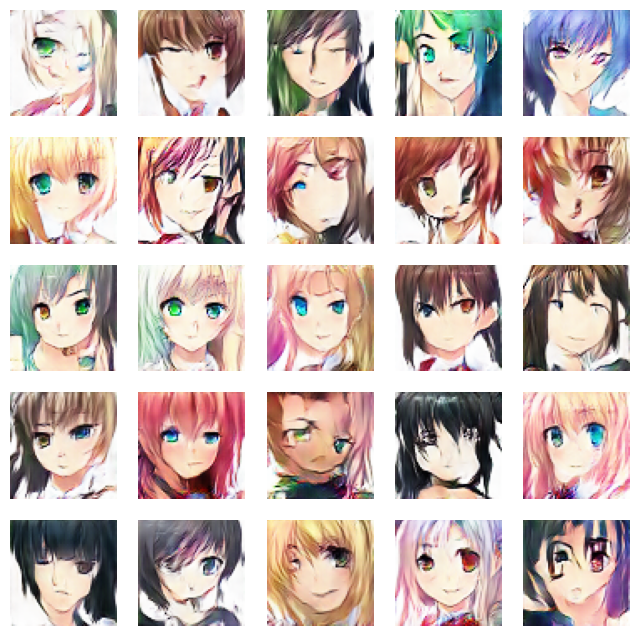

674/674 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - d_loss: 0.7934 - g_loss: 0.0000e+00
Epoch 37/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - d_loss: 0.7946 - g_loss: 0.0000e+00

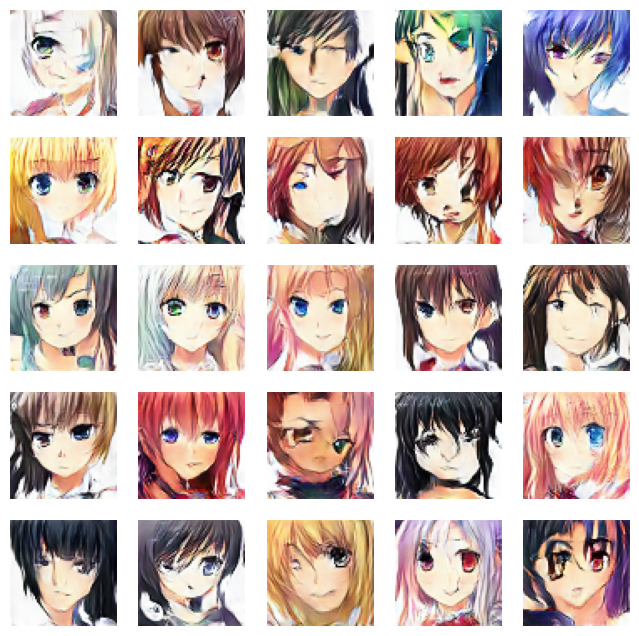

674/674 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - d_loss: 0.7946 - g_loss: 0.0000e+00
Epoch 38/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - d_loss: 0.7994 - g_loss: 0.0000e+00

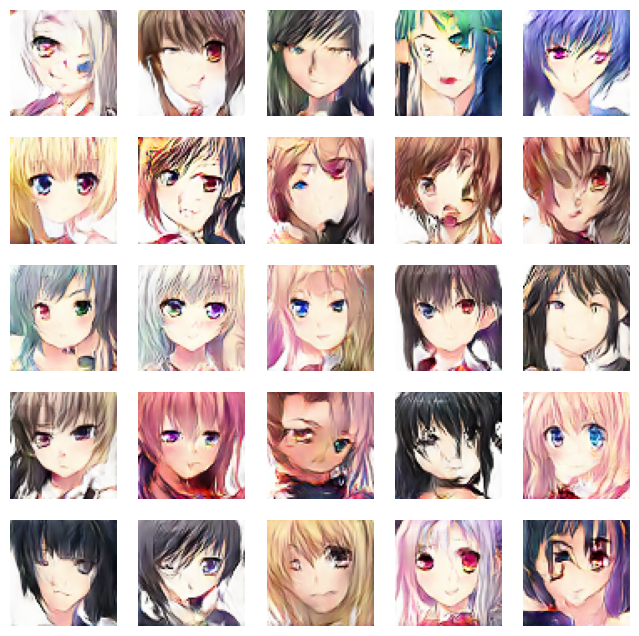

674/674 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - d_loss: 0.7994 - g_loss: 0.0000e+00
Epoch 39/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - d_loss: 0.8083 - g_loss: 0.0000e+00

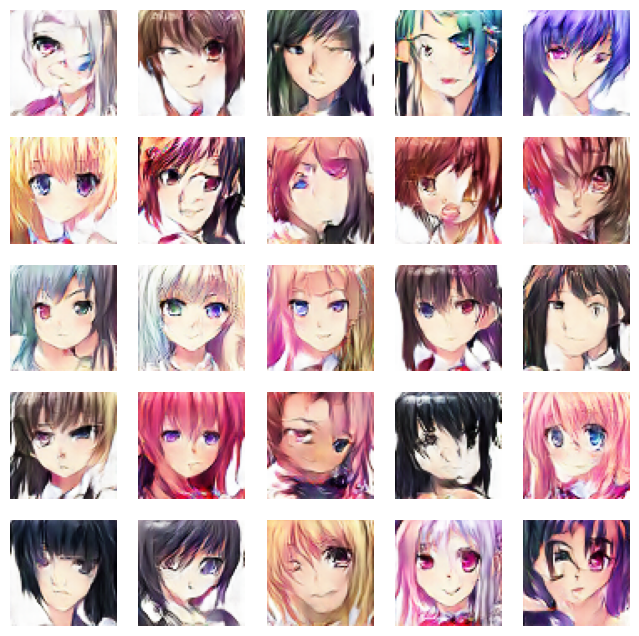

674/674 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - d_loss: 0.8083 - g_loss: 0.0000e+00
Epoch 40/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - d_loss: 0.8141 - g_loss: 0.0000e+00

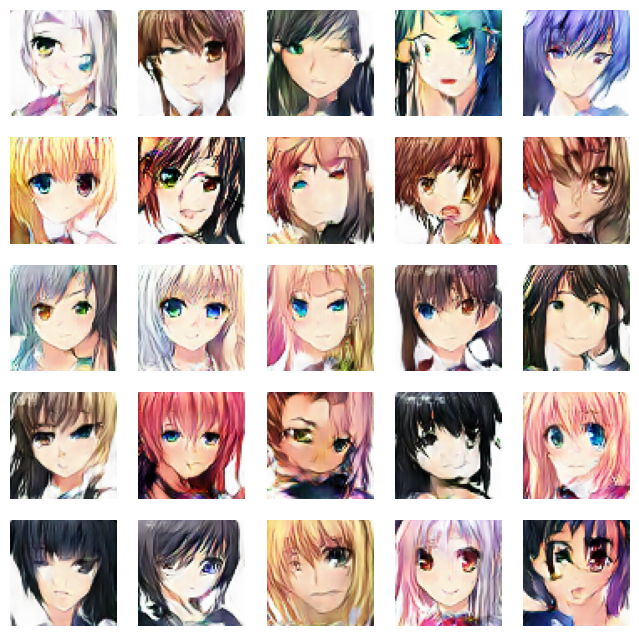

674/674 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - d_loss: 0.8141 - g_loss: 0.0000e+00
Epoch 41/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - d_loss: 0.8181 - g_loss: 0.0000e+00

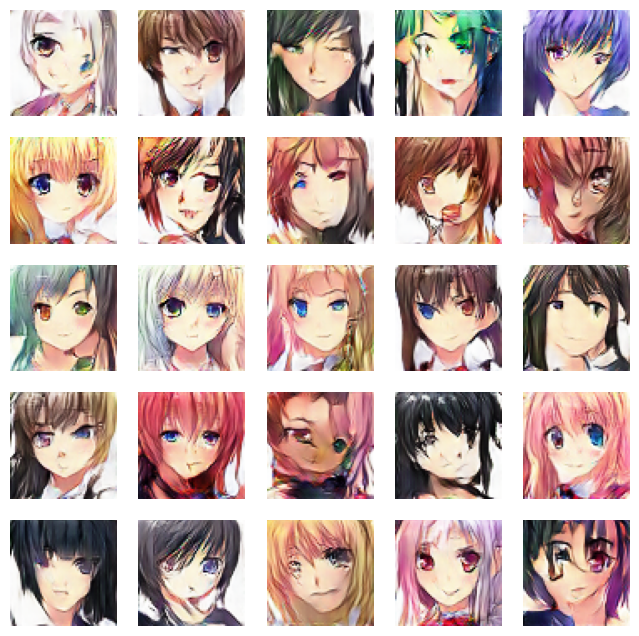

674/674 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - d_loss: 0.8181 - g_loss: 0.0000e+00
Epoch 42/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - d_loss: 0.8268 - g_loss: 0.0000e+00

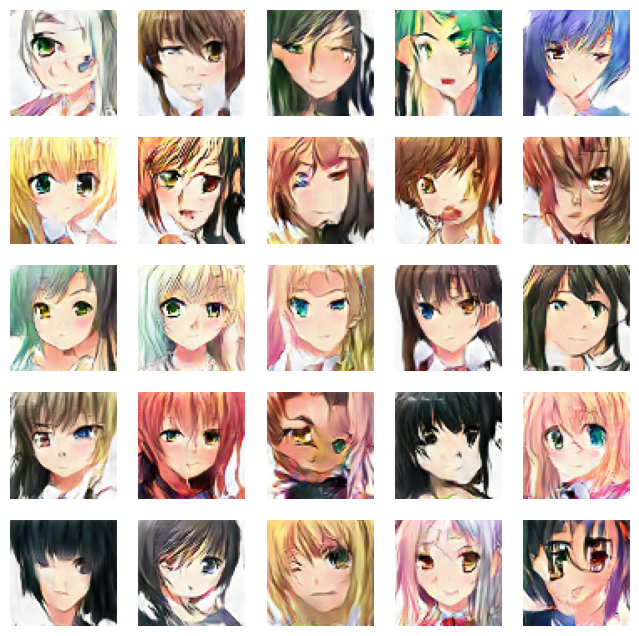

674/674 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - d_loss: 0.8268 - g_loss: 0.0000e+00
Epoch 43/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - d_loss: 0.8329 - g_loss: 0.0000e+00

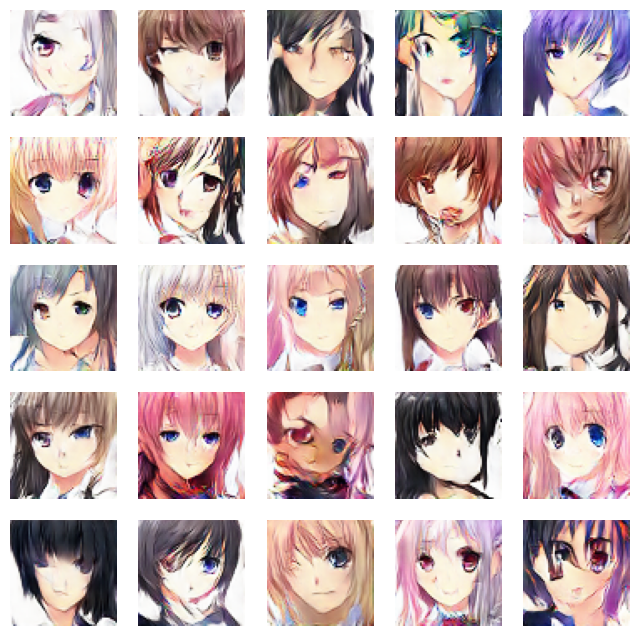

674/674 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - d_loss: 0.8329 - g_loss: 0.0000e+00
Epoch 44/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - d_loss: 0.8370 - g_loss: 0.0000e+00

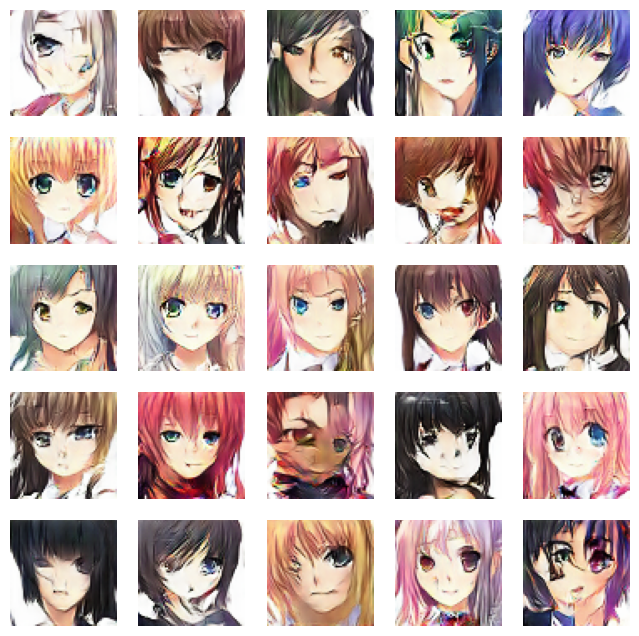

674/674 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - d_loss: 0.8370 - g_loss: 0.0000e+00
Epoch 45/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - d_loss: 0.8426 - g_loss: 0.0000e+00

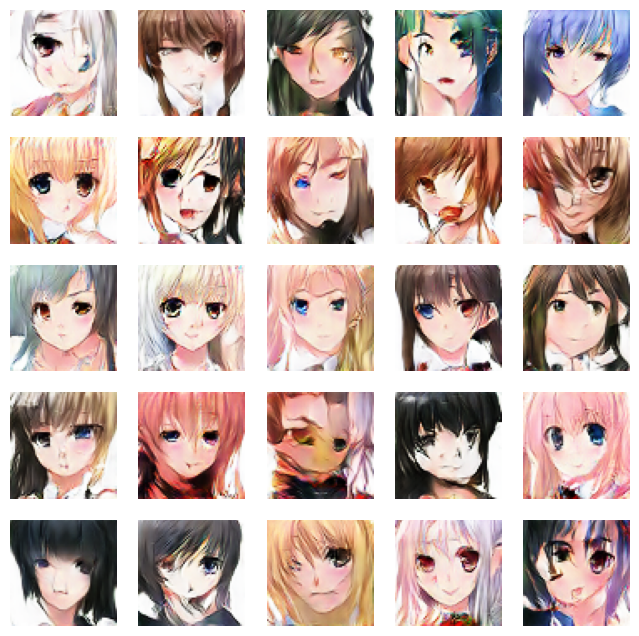

674/674 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - d_loss: 0.8426 - g_loss: 0.0000e+00
Epoch 46/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - d_loss: 0.8412 - g_loss: 0.0000e+00

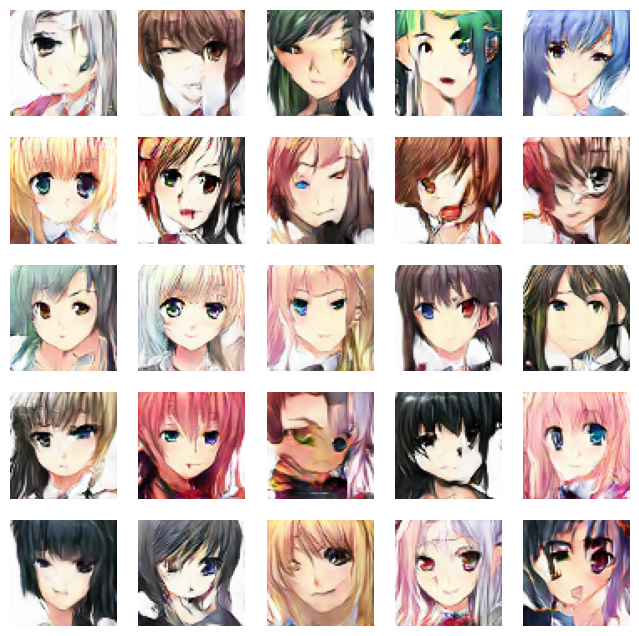

674/674 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - d_loss: 0.8412 - g_loss: 0.0000e+00
Epoch 47/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - d_loss: 0.8508 - g_loss: 0.0000e+00

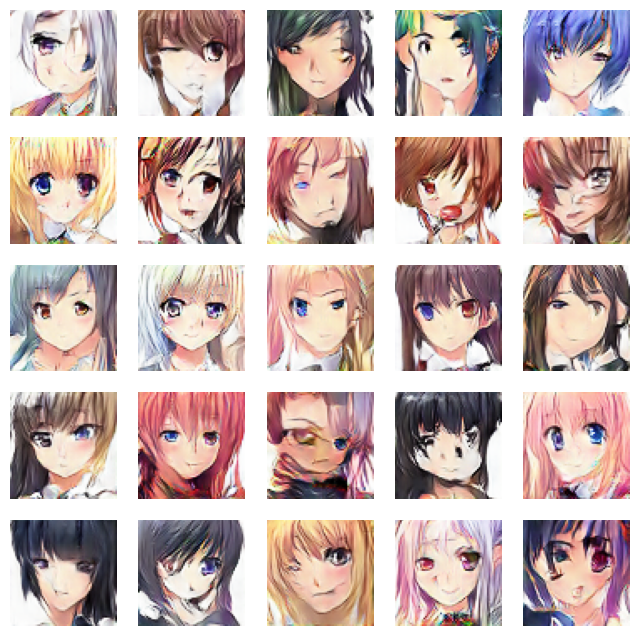

674/674 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - d_loss: 0.8509 - g_loss: 0.0000e+00
Epoch 48/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step - d_loss: 0.8488 - g_loss: 0.0000e+00

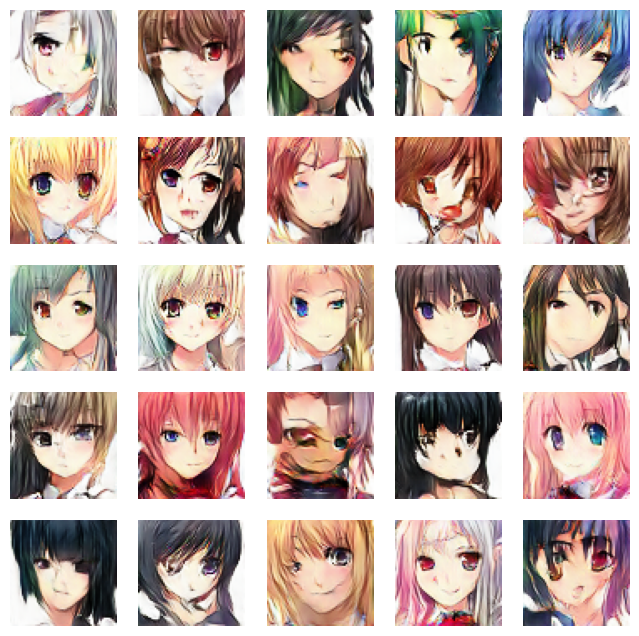

674/674 ━━━━━━━━━━━━━━━━━━━━ 21s 31ms/step - d_loss: 0.8488 - g_loss: 0.0000e+00
Epoch 49/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - d_loss: 0.8606 - g_loss: 0.0000e+00

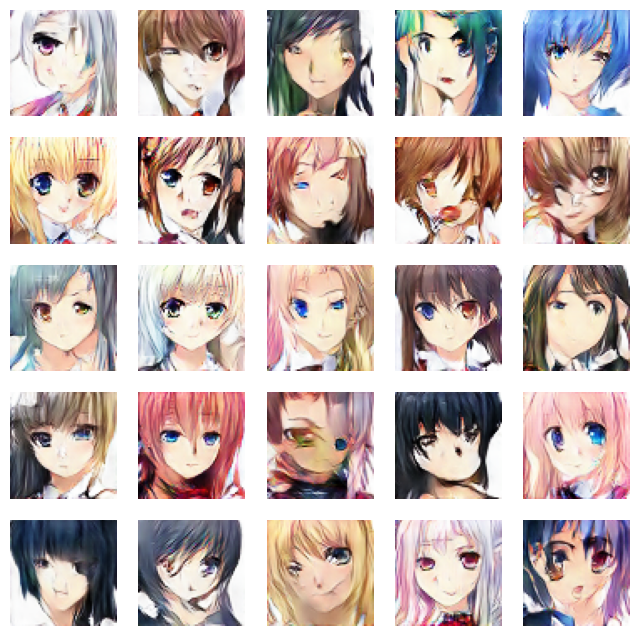

674/674 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - d_loss: 0.8606 - g_loss: 0.0000e+00
Epoch 50/50
673/674 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - d_loss: 0.8663 - g_loss: 0.0000e+00

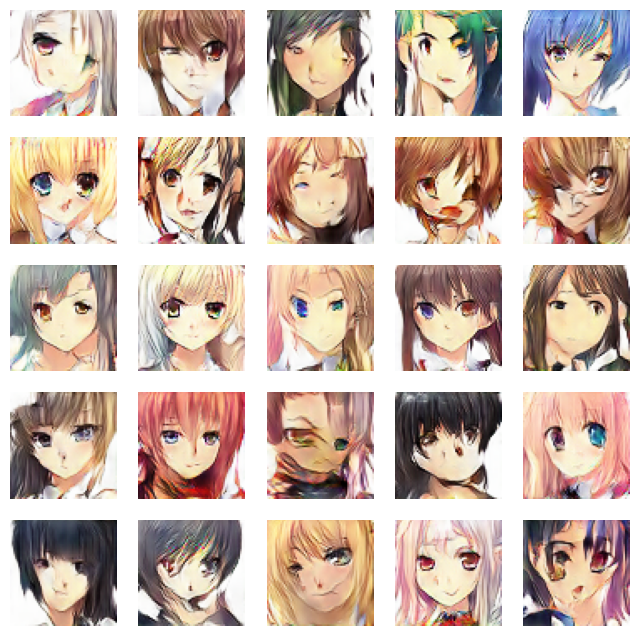

674/674 ━━━━━━━━━━━━━━━━━━━━ 20s 30ms/step - d_loss: 0.8663 - g_loss: 0.0000e+00


In [ ]:
N_EPOCHS=50
dcgan.fit(train_images,epochs=N_EPOCHS,callbacks=[DCGANMonitor()])

## Generate new Anime images

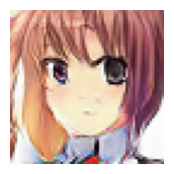

In [ ]:
noise=tf.random.normal([1,100])
fig=plt.figure(figsize=(2,2))
g_img=dcgan.generator(noise)
g_img=(g_img * 127.5)+127.5
g_img.numpy()
img=array_to_img(g_img[0])
plt.imshow(img)
plt.axis('off')
plt.show()